In [ ]:
pip install qutip

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.0/28.0 MB 19.0 MB/s eta 0:00:00


In [ ]:
import numpy as np
from qutip import tensor, basis, sigmax, sigmay, sigmaz, qeye,entropy_vn,expect
import qutip as qt

In [ ]:


# Define Pauli matrices for convenience
sx = sigmax()
sy = sigmay()
sz = sigmaz()
I = qeye(2)


# Number of qubits
N = 8

In [ ]:



# Coupling constants and external field
J1 = .0
J2 = 0.5
h = 0.3
D = 0.1

# Function to construct the Hamiltonian
def construct_hamiltonian(N, J1, J2, h, D):
    H = 0

    # Nearest-neighbor interactions (J1 term)
    for i in range(N):
        H += -J1 * tensor([sz if j == i else sz if j == (i + 1) % N else I for j in range(N)])

    # Next-nearest-neighbor interactions (J2 term)
    for i in range(N):
        H += -J2 * tensor([sz if j == i else sz if j == (i + 2) % N else I for j in range(N)])

    # External field (h term)
    for i in range(N):
        H += -h * tensor([sz if j == i else I for j in range(N)])

    # Three-spin interaction (D term)
    for i in range(N):
        H += -D * tensor([sz if j == i else sz if j == (i + 1) % N else sz if j == (i + 2) % N else I for j in range(N)])

    return H

# Construct the Hamiltonian for the 8-qubit system
H = construct_hamiltonian(N, J1, J2, h, D)

# Find the ground state and its energy
eigenvalues, eigenstates = H.eigenstates()
ground_state_energy = eigenvalues[0]
ground_state = eigenstates[0]



In [ ]:


# Define Pauli matrices and identity matrix
sx = sigmax()
sz = sigmaz()
I = qeye(2)

# Number of qubits
N = 8

# Coupling constants
J1 = 1.0
J2 = 0.

# Function to construct the Hamiltonian
def construct_hamiltonian(N, J1, J2):
    H = 0

    for j in range(N):
        # Z_j term
        H += tensor([sz if k == j else I for k in range(N)])

        # -J1 X_j X_{j+1} term (with periodic boundary conditions)
        H += -J1 * tensor([sx if k == j else sx if k == (j + 1) else I for k in range(N)])

        # -J2 X_{j-1} Z_j X_{j+1} term (with periodic boundary conditions)
        H += -J2 * tensor([sx if k == (j - 1)  else sz if k == j else sx if k == (j + 1) else I for k in range(N)])

    return H

#cubic hamiltonian
def construct_hamiltonian(N=8,J1=0,J2=0):
  H = 0
  #each spin separetely
  for j in range(N):
      # Z_j term
      H += tensor([sz if k == j else I for k in range(N)])

  #top and bottom separately
  top_indexes=[x for x in range(int(N/2))]*2
  for j in range(int(N/2)):
      # -J1 X_j X_{j+1} term (with periodic boundary conditions)
      H += -J1 * tensor([sx if k == j else sx if k == top_indexes[(j + 1)] else I for k in range(int(N/2))]+\
                        [I]*int(N/2))

  bottom_indexes=[x for x in range(int(N/2),N)]*3
  for j in range(int(N/2),N):
      # -J1 X_j X_{j+1} term (with periodic boundary conditions)
      H += -J1 * tensor([I]*int(N/2)+\
      [sx if k == j else sx if k == bottom_indexes[(j + 1)] else I for k in range(int(N/2),N)])


  #coonnections between top and bottom
  for j in range(int(N/2)):
      # -J2 X_{j-1} Z_j X_{j+1} term (with periodic boundary conditions)
      H += -J2 * tensor([sx if k == j  else sz if k == (j+int(N/2))  else I for k in range(N)])

  return H

# Construct the Hamiltonian for the 8-qubit system
H = construct_hamiltonian(N, J1, J2)

# Find the ground state and its energy
eigenvalues, eigenstates = H.eigenstates()
ground_state_energy = eigenvalues[0]
ground_state = eigenstates[0]

#print("Ground state energy:", ground_state_energy)
print("Ground state:\n", ground_state)

Ground state:
 Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2], [1, 1, 1, 1, 1, 1, 1, 1]], shape=(256, 1), type='ket', dtype=Dense
Qobj data =
[[-1.17476064e-02]
 [-2.77555756e-17]
 [-8.32667268e-17]
 [-2.70965939e-02]
 [-1.11022302e-16]
 [-2.07388351e-02]
 [-2.70965939e-02]
 [-1.38777878e-17]
 [-3.46944695e-18]
 [-2.70965939e-02]
 [-2.07388351e-02]
 [-5.05620379e-18]
 [-2.70965939e-02]
 [-3.14296426e-18]
 [-5.05620379e-18]
 [-8.83883476e-02]
 [ 1.92592994e-34]
 [ 0.00000000e+00]
 [-4.81482486e-35]
 [ 6.01853108e-36]
 [-6.01853108e-36]
 [ 5.26621469e-36]
 [ 1.05324294e-35]
 [-6.20661017e-36]
 [-3.94966102e-36]
 [ 1.04854096e-35]
 [ 3.64403249e-36]
 [-8.49882416e-36]
 [ 1.05324294e-35]
 [-6.25767071e-36]
 [-8.49441605e-36]
 [ 1.01748120e-35]
 [ 7.08471204e-36]
 [-3.01920191e-36]
 [-5.01922771e-36]
 [ 3.47919073e-36]
 [-1.62430210e-36]
 [ 2.56752788e-36]
 [ 3.95933627e-36]
 [-3.23113921e-36]
 [-1.58844274e-36]
 [ 3.91854427e-36]
 [ 2.57590617e-36]
 [-3.62907608e-36]
 [ 3.92177855e-36]
 [-

## each satate separately

In [ ]:
H = construct_hamiltonian(N, J1=0, J2=-1)

# Find the ground state and its energy
eigenvalues, eigenstates = H.eigenstates()
ground_state_energy = eigenvalues[0]
ground_state = eigenstates[0]


In [ ]:
ground_state

Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2], [1, 1, 1, 1, 1, 1, 1, 1]], shape=(256, 1), type='ket', dtype=Dense
Qobj data =
[[-2.39920063e-48]
 [ 4.30359441e-17]
 [-8.03083460e-19]
 [ 4.96203379e-18]
 [ 1.33602639e-18]
 [ 1.14518067e-17]
 [-5.33301692e-18]
 [ 1.04507555e-17]
 [ 1.29135122e-17]
 [ 7.55072439e-18]
 [-3.34753261e-17]
 [ 5.34420334e-17]
 [ 5.54353119e-18]
 [ 9.92087360e-18]
 [-6.98243065e-18]
 [-2.14466094e-02]
 [-4.08337643e-17]
 [-8.17725607e-18]
 [-1.81061763e-17]
 [ 1.43114687e-17]
 [-1.21591677e-17]
 [ 1.12757026e-17]
 [-7.15573434e-18]
 [-1.95156391e-17]
 [-3.66189284e-17]
 [-6.18266289e-17]
 [-3.67227222e-17]
 [-9.58282577e-19]
 [-5.76355116e-18]
 [-4.93397976e-19]
 [ 3.46944695e-18]
 [-5.17766953e-02]
 [ 1.42030485e-17]
 [ 4.36052561e-18]
 [-5.96311195e-18]
 [ 9.32413868e-18]
 [ 5.89226191e-20]
 [ 4.33680869e-19]
 [ 5.85469173e-18]
 [-8.67361738e-19]
 [ 9.02598309e-18]
 [ 1.05709712e-18]
 [ 9.99713866e-18]
 [ 3.97483731e-18]
 [-1.75200312e-18]
 [-1.83763670e-18]

In [ ]:
np.linalg.norm(ground_state.full())

1.0

In [ ]:
each_spin_x=[]
for j in range(N):
    # Magnetization in x direction
    mx = tensor([sx if k == j else I for k in range(N)])
    each_spin_x.append(qt.expect(mx, ground_state))

In [ ]:
each_spin_x

[0.7071067811865476,
 0.7071067811865476,
 0.7071067811865476,
 0.7071067811865476,
 -5.5109562821191166e-17,
 3.1284104889541344e-18,
 -9.344011984753096e-18,
 -2.206627378290907e-17]

## measured values

In [ ]:
state_energy = eigenvalues[0]
ground_state = eigenstates[0]

# Function to compute magnetization
def compute_magnetization(state, N):
    total_magnetization_x = 0
    total_magnetization_y = 0
    total_magnetization_z = 0

    for j in range(N):
        # Magnetization in x direction
        mx = tensor([sx if k == j else I for k in range(N)])
        total_magnetization_x += qt.expect(mx, state)

        # Magnetization in x direction
        my = tensor([sy if k == j else I for k in range(N)])
        total_magnetization_y += qt.expect(my, state)

        # Magnetization in z direction
        mz = tensor([sz if k == j else I for k in range(N)])
        total_magnetization_z += qt.expect(mz, state)

    return total_magnetization_x, total_magnetization_y, total_magnetization_z

# Compute the magnetization of the ground state
magnetization_x,total_magnetization_y, magnetization_z = compute_magnetization(ground_state, N)



In [ ]:
#get heatmap
def get_mes_vals(J1,J2,N=8):
    H = construct_hamiltonian(N, J1, J2)
    # Find the ground state and its energy
    eigenvalues, eigenstates = H.eigenstates()
    ground_state_energy = eigenvalues[0]
    ground_state = eigenstates[0]
    magnetization_x,total_magnetization_y, magnetization_z = compute_magnetization(ground_state, N)
    return magnetization_x,total_magnetization_y,magnetization_z


mag_x,mag_y,mag_z=get_mes_vals(J1,J2,)
# Compute energy gap
def energy_gap(eigenvalues):
    return eigenvalues[1] - eigenvalues[0]

# Compute entanglement entropy
def entanglement_entropy(state, N):
    # Partition the system into two halves
    subsystem_size = N // 2
    subsystem_A_indices = list(range(subsystem_size))
    rho_A = state.ptrace(subsystem_A_indices)
    return entropy_vn(rho_A)

# Compute specific heat
def specific_heat(eigenvalues, temperature):
    beta = 1 / temperature
    Z = np.sum(np.exp(-beta * eigenvalues))
    E_avg = np.sum(eigenvalues * np.exp(-beta * eigenvalues)) / Z
    E2_avg = np.sum(eigenvalues**2 * np.exp(-beta * eigenvalues)) / Z
    return (E2_avg - E_avg**2) * beta**2

def system_sz(N):
    """ Construct the system-wide Sz operator. """
    sz_list = []
    for j in range(N):
        operator_list = [I] * N
        operator_list[j] = sz
        sz_list.append(tensor(operator_list))
    return sum(sz_list)
sz_total = system_sz(N)

# Function to calculate susceptibility
def susceptibility(eigenstates, eigenvalues, temperature):
    beta = 1 / temperature
    Z = np.sum(np.exp(-beta * eigenvalues))  # Partition function
    M = [abs(expect(sz_total, state)) for state in eigenstates]  # Correct usage of expect with the total Sz
    M_avg = np.sum(np.array(M) * np.exp(-beta * eigenvalues)) / Z
    M2_avg = np.sum((np.array(M)**2) * np.exp(-beta * eigenvalues)) / Z
    return (M2_avg - M_avg**2) * beta


In [ ]:
ground_states=[]
mesh_x=np.zeros((len(np.arange(-2,2,0.1)),len(np.arange(-2,2,0.1))))
mesh_y=mesh_x.copy()
mesh_z=mesh_x.copy()
mesh_gap=mesh_x.copy()
mesh_entropy=mesh_x.copy()
mesh_cv=mesh_x.copy()
mesh_chi=mesh_x.copy()
ground_states = {}

index2j1j2={}
for k,J1 in enumerate(np.arange(-4,4,0.2)):
  for i,J2 in enumerate(np.arange(4,-4,-0.2)):

    mag_x,mag_y,mag_z=get_mes_vals(J1,J2,)
    mesh_x[i,k]=mag_x
    mesh_y[i,k]=mag_y

    mesh_z[i,k]=mag_z


    H = construct_hamiltonian(N, J1, J2)
    # Find the ground state and its energy
    eigenvalues, eigenstates = H.eigenstates()
    ground_state_energy = eigenvalues[0]
    ground_state = eigenstates[0]
    gap=energy_gap(eigenvalues)
    entropy = entanglement_entropy(eigenstates[0], N)
    cv = specific_heat(eigenvalues, 1.0)  # Example temperature 1.0
    chi = susceptibility(eigenstates, eigenvalues, 1.0)  # Example temperature 1.0

    ground_states[(i,k)]=ground_state
    mesh_gap[i,k]=gap
    mesh_entropy[i,k]=entropy
    mesh_cv[i,k]=cv
    mesh_chi[i,k]=chi


KeyboardInterrupt: 

In [ ]:


index2j1j2={}
for k,J1 in enumerate(np.arange(-4,4,0.2)):
  for i,J2 in enumerate(np.arange(4,-4,-0.2)):

    index2j1j2[(i,k)]=[J1,J2]

In [ ]:
ground_states_j1j2={tuple(index2j1j2[key]):ground_states[key].full()[:,0] for key in list(ground_states.keys())}
ground_states_j1j2

{(-4.0,
  4.0): array([-4.43529047e-02-0.j,  0.00000000e+00+0.j,  5.55111512e-17+0.j,
         7.00420594e-02+0.j, -1.11022302e-16+0.j, -1.33363239e-01+0.j,
         7.00420594e-02+0.j,  1.38777878e-17+0.j,  2.77555756e-17+0.j,
         7.00420594e-02+0.j, -1.33363239e-01+0.j, -2.12503626e-17+0.j,
         7.00420594e-02+0.j,  3.01408204e-17+0.j, -1.88786703e-17+0.j,
        -6.48305877e-02+0.j,  1.18681423e-03+0.j, -1.25298702e-18-0.j,
         1.24000855e-17+0.j,  1.77983798e-03+0.j, -3.83599002e-18-0.j,
         1.12681578e-01+0.j, -1.46286637e-03-0.j, -5.48830799e-18+0.j,
         8.06086559e-18+0.j,  1.77983798e-03+0.j, -1.12826596e-01+0.j,
        -8.13609772e-18-0.j, -1.46286637e-03-0.j, -6.38265071e-18+0.j,
        -8.32628270e-18-0.j, -2.42218453e-03+0.j,  1.18681423e-03+0.j,
         2.42686985e-20+0.j, -1.21180534e-17-0.j,  1.77983798e-03+0.j,
        -1.49752646e-17-0.j, -1.12826596e-01-0.j,  1.77983798e-03+0.j,
         5.85053219e-18+0.j, -4.94551617e-18-0.j, -1.46286637e

In [ ]:
ground_states_j1j2

{(-4.0,
  4.0): array([[-4.43529047e-02-0.j],
        [ 0.00000000e+00+0.j],
        [ 5.55111512e-17+0.j],
        [ 7.00420594e-02+0.j],
        [-1.11022302e-16+0.j],
        [-1.33363239e-01+0.j],
        [ 7.00420594e-02+0.j],
        [ 1.38777878e-17+0.j],
        [ 2.77555756e-17+0.j],
        [ 7.00420594e-02+0.j],
        [-1.33363239e-01+0.j],
        [-2.12503626e-17+0.j],
        [ 7.00420594e-02+0.j],
        [ 3.01408204e-17+0.j],
        [-1.88786703e-17+0.j],
        [-6.48305877e-02+0.j],
        [ 1.18681423e-03+0.j],
        [-1.25298702e-18-0.j],
        [ 1.24000855e-17+0.j],
        [ 1.77983798e-03+0.j],
        [-3.83599002e-18-0.j],
        [ 1.12681578e-01+0.j],
        [-1.46286637e-03-0.j],
        [-5.48830799e-18+0.j],
        [ 8.06086559e-18+0.j],
        [ 1.77983798e-03+0.j],
        [-1.12826596e-01+0.j],
        [-8.13609772e-18-0.j],
        [-1.46286637e-03-0.j],
        [-6.38265071e-18+0.j],
        [-8.32628270e-18-0.j],
        [-2.42218453e-03

In [ ]:
df=pd.DataFrame(ground_states_j1j2)
df=df.T.astype(float)
df=df.reset_index()
df.columns=["J1","J2"]+[x for x in range(256)]
df

/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/astype.py:134: ComplexWarning: Casting complex values to real discards the imaginary part
  return arr.astype(dtype, copy=True)


,J1,J2,0,1,2,3,4,5,6,7,...,246,247,248,249,250,251,252,253,254,255
0,-4.0,4.0,-0.044353,0.000000e+00,5.551115e-17,0.070042,-1.110223e-16,-0.133363,0.070042,1.387779e-17,...,0.113226,2.136017e-17,1.782282e-17,0.113226,-0.195984,-2.280577e-17,0.113226,2.331751e-17,-2.252288e-17,-0.109368
1,-4.0,3.8,-0.046817,-2.775558e-17,1.110223e-16,0.072360,-1.110223e-16,-0.131188,0.072360,1.387779e-17,...,0.117363,2.580067e-17,2.798363e-17,0.117363,-0.194382,-3.660423e-17,0.117363,2.542754e-17,-3.679137e-17,-0.116589
2,-4.0,3.6,-0.049326,-5.551115e-17,1.110223e-16,0.074671,-2.220446e-16,-0.128852,0.074671,5.551115e-17,...,0.121487,3.799595e-17,2.761454e-17,0.121487,-0.192526,-3.650684e-17,0.121487,3.594092e-17,-3.656145e-17,-0.124025
3,-4.0,3.4,-0.051853,2.775558e-17,-5.551115e-17,0.076948,-1.110223e-16,-0.126366,0.076948,-4.163336e-17,...,0.125544,-8.588847e-17,-6.125213e-17,0.125544,-0.190421,7.626972e-17,0.125544,-8.724931e-17,7.629366e-17,-0.131591
4,-4.0,3.2,-0.054363,-1.110223e-16,1.665335e-16,0.079161,0.000000e+00,-0.123753,0.079161,6.938894e-17,...,0.129482,1.236489e-16,1.029446e-16,0.129482,-0.188078,-1.333806e-16,0.129482,1.233479e-16,-1.332961e-16,-0.139190
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1595,3.8,-3.0,-0.019098,5.551115e-17,5.551115e-17,-0.047126,2.775558e-17,-0.034702,-0.047126,0.000000e+00,...,-0.077335,3.226040e-17,1.937913e-17,-0.077335,-0.058626,2.736540e-17,-0.077335,2.617154e-17,2.753164e-17,-0.252671
1596,3.8,-3.2,-0.017732,5.551115e-17,5.551115e-17,-0.045460,-5.551115e-17,-0.032539,-0.045460,1.110223e-16,...,-0.074304,1.546330e-17,1.503391e-17,-0.074304,-0.054914,1.720138e-17,-0.074304,1.569528e-17,1.741747e-17,-0.256431
1597,3.8,-3.4,-0.016474,-3.469447e-17,-1.387779e-17,-0.043847,-5.551115e-17,-0.030497,-0.043847,0.000000e+00,...,-0.071372,-6.549592e-18,-2.114320e-18,-0.071372,-0.051406,-3.934449e-18,-0.071372,-4.455272e-18,-4.383568e-18,-0.259713
1598,3.8,-3.6,0.015320,0.000000e+00,1.387779e-17,0.042294,-2.775558e-17,0.028581,0.042294,-2.220446e-16,...,0.068553,-1.209091e-17,1.319490e-18,0.068553,0.048113,-5.810973e-18,0.068553,-5.441062e-18,-6.275068e-18,0.262559


0             1             2         3             4    \
-4.0  4.0 -0.044353  0.000000e+00  5.551115e-17  0.070042 -1.110223e-16   
      3.8 -0.046817 -2.775558e-17  1.110223e-16  0.072360 -1.110223e-16   
      3.6 -0.049326 -5.551115e-17  1.110223e-16  0.074671 -2.220446e-16   
      3.4 -0.051853  2.775558e-17 -5.551115e-17  0.076948 -1.110223e-16   
      3.2 -0.054363 -1.110223e-16  1.665335e-16  0.079161  0.000000e+00   
...             ...           ...           ...       ...           ...   
 3.8 -3.0 -0.019098  5.551115e-17  5.551115e-17 -0.047126  2.775558e-17   
     -3.2 -0.017732  5.551115e-17  5.551115e-17 -0.045460 -5.551115e-17   
     -3.4 -0.016474 -3.469447e-17 -1.387779e-17 -0.043847 -5.551115e-17   
     -3.6  0.015320  0.000000e+00  1.387779e-17  0.042294 -2.775558e-17   
     -3.8 -0.014263  4.163336e-17  1.387779e-17 -0.040808  5.551115e-17   

                5         6             7             8         9    ...  \
-4.0  4.0 -0.133363  0.070042  1.387779e-17  2.775558e-17  0.070042  ...   
      3.8 -0.131188  0.072360  1.387779e-17  2.081668e-17  0.072360  ...   
      3.6 -0.128852  0.074671  5.551115e-17  3.469447e-17  0.074671  ...   
      3.4 -0.126366  0.076948 -4.163336e-17 -5.551115e-17  0.076948  ...   
      3.2 -0.123753  0.079161  6.938894e-17  6.938894e-17  0.079161  ...   
...             ...       ...           ...           ...       ...  ...   
 3.8 -3.0 -0.034702 -0.047126  0.000000e+00  5.551115e-17 -0.047126  ...   
     -3.2 -0.032539 -0.045460  1.110223e-16  1.110223e-16 -0.045460  ...   
     -3.4 -0.030497 -0.043847  0.000000e+00  0.000000e+00 -0.043847  ...   
     -3.6  0.028581  0.042294 -2.220446e-16  1.110223e-16  0.042294  ...   
     -3.8 -0.026792 -0.040808  3.330669e-16  2.220446e-16 -0.040808  ...   

                246           247           248       249       250  \
-4.0  4.0  0.113226  2.136017e-17  1.782282e-17  0.113226 -0.195984   
      3.8  0.117363  2.580067e-17  2.798363e-17  0.117363 -0.194382   
      3.6  0.121487  3.799595e-17  2.761454e-17  0.121487 -0.192526   
      3.4  0.125544 -8.588847e-17 -6.125213e-17  0.125544 -0.190421   
      3.2  0.129482  1.236489e-16  1.029446e-16  0.129482 -0.188078   
...             ...           ...           ...       ...       ...   
 3.8 -3.0 -0.077335  3.226040e-17  1.937913e-17 -0.077335 -0.058626   
     -3.2 -0.074304  1.546330e-17  1.503391e-17 -0.074304 -0.054914   
     -3.4 -0.071372 -6.549592e-18 -2.114320e-18 -0.071372 -0.051406   
     -3.6  0.068553 -1.209091e-17  1.319490e-18  0.068553  0.048113   
     -3.8 -0.065858  3.215690e-17  2.144237e-17 -0.065858 -0.045036   

                    251       252           253           254       255  
-4.0  4.0 -2.280577e-17  0.113226  2.331751e-17 -2.252288e-17 -0.109368  
      3.8 -3.660423e-17  0.117363  2.542754e-17 -3.679137e-17 -0.116589  
      3.6 -3.650684e-17  0.121487  3.594092e-17 -3.656145e-17 -0.124025  
      3.4  7.626972e-17  0.125544 -8.724931e-17  7.629366e-17 -0.131591  
      3.2 -1.333806e-16  0.129482  1.233479e-16 -1.332961e-16 -0.139190  
...                 ...       ...           ...           ...       ...  
 3.8 -3.0  2.736540e-17 -0.077335  2.617154e-17  2.753164e-17 -0.252671  
     -3.2  1.720138e-17 -0.074304  1.569528e-17  1.741747e-17 -0.256431  
     -3.4 -3.934449e-18 -0.071372 -4.455272e-18 -4.383568e-18 -0.259713  
     -3.6 -5.810973e-18  0.068553 -5.441062e-18 -6.275068e-18  0.262559  
     -3.8  2.909359e-17 -0.065858  2.726181e-17  2.949524e-17 -0.265010  

[1600 rows x 256 columns]

Text(50.722222222222214, 0.5, 'j2')

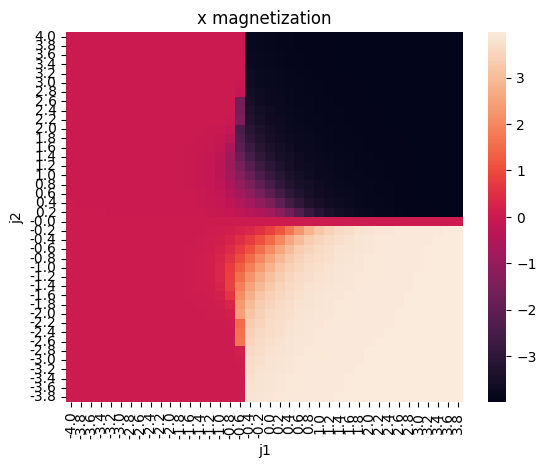

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.heatmap(mesh_x,
            xticklabels=np.round(np.arange(-4,4,0.2), 2),
            yticklabels=np.round(np.arange(4,-4,-0.2), 2))
plt.title("x magnetization")
plt.xlabel("j1")
plt.ylabel("j2")

Text(50.722222222222214, 0.5, 'j2')

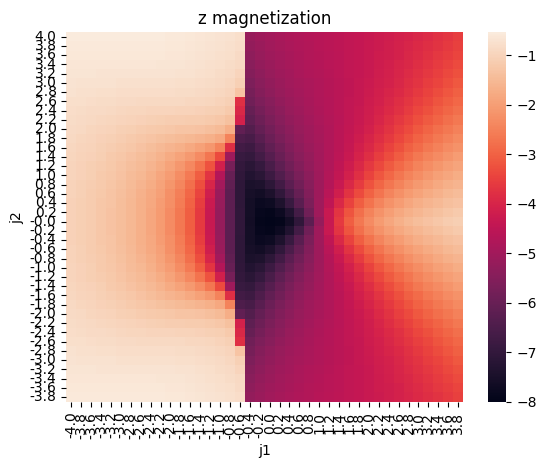

In [ ]:
sns.heatmap(mesh_z,
            xticklabels=np.round(np.arange(-4,4,0.2), 2),
            yticklabels=np.round(np.arange(4,-4,-0.2), 2))
plt.title("z magnetization")
plt.xlabel("j1")
plt.ylabel("j2")

In [ ]:
mesh_x,

(array([[-1.05192160e-03, -1.11783713e-03, -1.17742410e-03, ...,
         -3.97837663e+00, -3.97956921e+00, -3.98066470e+00],
        [-1.15844086e-03, -1.24706800e-03, -1.33165636e-03, ...,
         -3.97734296e+00, -3.97862553e+00, -3.97980485e+00],
        [-1.26471179e-03, -1.37988554e-03, -1.49494306e-03, ...,
         -3.97624043e+00, -3.97762519e+00, -3.97889957e+00],
        ...,
        [ 1.36688710e-03,  1.51195207e-03,  1.66279911e-03, ...,
          3.97506692e+00,  3.97656819e+00,  3.97795056e+00],
        [ 1.26471179e-03,  1.37988554e-03,  1.49494306e-03, ...,
          3.97624043e+00,  3.97762519e+00,  3.97889957e+00],
        [ 1.15844086e-03,  1.24706800e-03,  1.33165636e-03, ...,
          3.97734296e+00,  3.97862553e+00,  3.97980485e+00]]),)

Text(50.722222222222214, 0.5, 'j2')

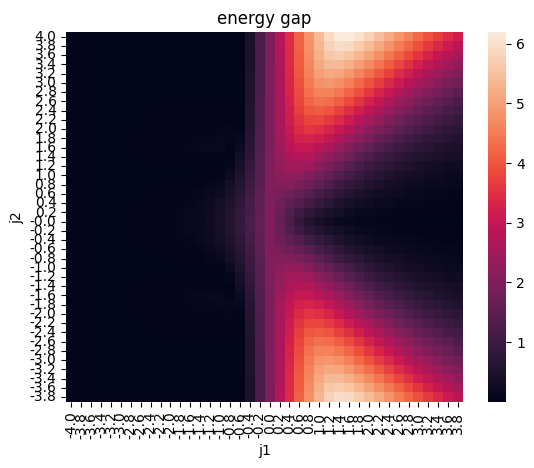

In [ ]:
sns.heatmap(mesh_gap,
            xticklabels=np.round(np.arange(-4,4,0.2), 2),
            yticklabels=np.round(np.arange(4,-4,-0.2), 2))
plt.title("energy gap")
plt.xlabel("j1")
plt.ylabel("j2")

Text(50.722222222222214, 0.5, 'j2')

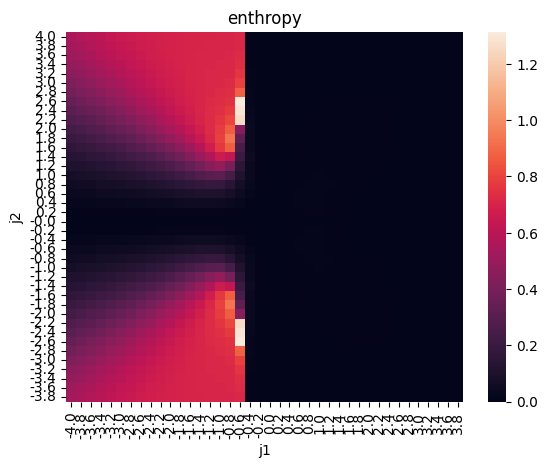

In [ ]:
sns.heatmap(mesh_entropy,
            xticklabels=np.round(np.arange(-4,4,0.2), 2),
            yticklabels=np.round(np.arange(4,-4,-0.2), 2))
plt.title("enthropy")
plt.xlabel("j1")
plt.ylabel("j2")

Text(50.722222222222214, 0.5, 'j2')

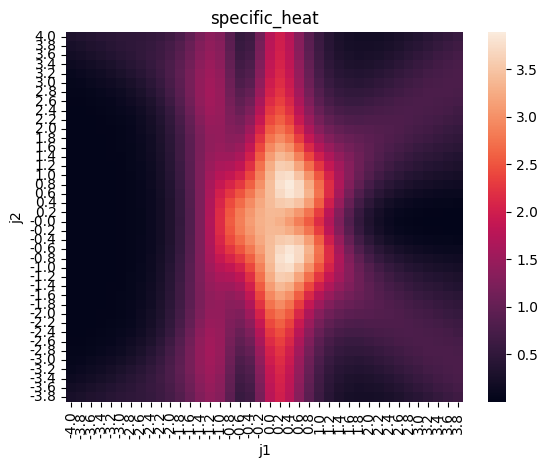

In [ ]:
sns.heatmap(mesh_cv,
            xticklabels=np.round(np.arange(-4,4,0.2), 2),
            yticklabels=np.round(np.arange(4,-4,-0.2), 2))
plt.title("specific_heat")
plt.xlabel("j1")
plt.ylabel("j2")

Text(50.722222222222214, 0.5, 'j2')

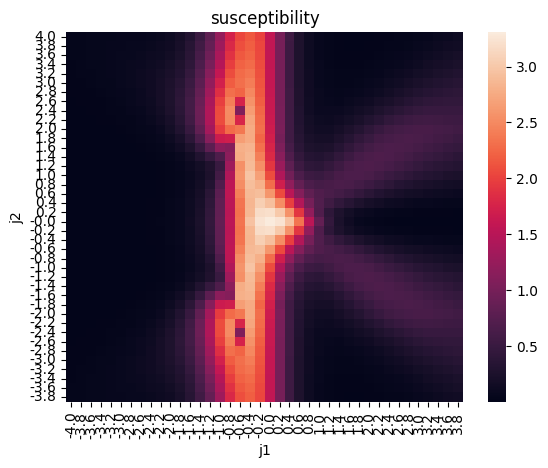

In [ ]:
sns.heatmap(mesh_chi,
            xticklabels=np.round(np.arange(-4,4,0.2), 2),
            yticklabels=np.round(np.arange(4,-4,-0.2), 2))
plt.title("susceptibility")
plt.xlabel("j1")
plt.ylabel("j2")

## data collection

In [ ]:
ground_states=[]
mesh_x=[]
mesh_y=[]
mesh_z=[]
mesh_gap=[]
mesh_entropy=[]
mesh_cv=[]
mesh_chi=[]
ground_states = []
J1_list=[]
J2_list=[]

index2j1j2={}
for k,J1 in enumerate(np.arange(-4,4,0.1)):
  for i,J2 in enumerate(np.arange(0,-4,-0.1)):
    J1_list.append(J1)
    J2_list.append(J2)

    mag_x,mag_y,mag_z=get_mes_vals(int(J1*10),int(J2*10),)
    mesh_x.append(mag_x)
    mesh_y.append(mag_y)
    mesh_z.append(mag_z)


    H = construct_hamiltonian(N, J1, J2)
    # Find the ground state and its energy
    eigenvalues, eigenstates = H.eigenstates()
    ground_state_energy = eigenvalues[0]
    ground_state = eigenstates[0]
    gap=energy_gap(eigenvalues)
    entropy = entanglement_entropy(eigenstates[0], N)
    cv = specific_heat(eigenvalues, 1.0)  # Example temperature 1.0
    chi = susceptibility(eigenstates, eigenvalues, 1.0)  # Example temperature 1.0

    ground_states.append(ground_state)
    mesh_gap.append(gap)
    mesh_entropy.append(entropy)
    mesh_cv.append(cv)
    mesh_chi.append(chi)


In [ ]:
#ground_states_array=np.array([x.full() for x in ground_states])[:,:,0]

In [ ]:
len(ground_states_array[state,:])

NameError: name 'ground_states_array' is not defined

In [ ]:
ground_states_array

In [ ]:
base_dict={"J1":J1_list,"J2":J2_list,"mag_x":mag_x,"mesh_y":mesh_y,"mesh_z":mesh_z,"gap":mesh_gap,"entropy":mesh_entropy,"cv":mesh_cv,"chi":mesh_chi}
base_dict.update({state:list(ground_states_array[:,state]) for state in range(ground_states_array.shape[1])})

In [ ]:
base_dict

{'J1': [-40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -40,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -39,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -38,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,
  -37,


## phase estimation

In [ ]:

def point_position_relative_to_lines(x, y, lines):
    """
    Determine if the point (x, y) is above, below, or on each line in a list of lines, including vertical lines.

    Args:
    x (float): x-coordinate of the point.
    y (float): y-coordinate of the point.
    lines (list of tuples): Each tuple contains either (m, b) for non-vertical lines or ('vertical', c) for vertical lines.

    Returns:
    list: Each element is 1 (above), 0 (on), or -1 (below) for each corresponding line. For vertical lines, 1 (right), -1 (left).
    """
    results = []
    if y>1e-12:
      raise ValueError("incorrect input")
    for line in lines:
        if line[0] == 'vertical':  # Check if the line is vertical
            c = line[1]
            if x > c:
                results.append(1)  # The point is to the right of the vertical line
            elif x < c:
                results.append(-1)  # The point is to the left of the vertical line
            else:
                results.append(0)  # The point is on the vertical line
        else:
            m, b = line
            line_y = m * x + b
            if y > line_y:
                results.append(1)  # The point is above the line
            elif y < line_y:
                results.append(-1)  # The point is below the line
            else:
                results.append(0)  # The point is on the line
    return results

# Example usage

lines = [(-9, -1.8), ('vertical', 0), (1.8, -1.8), (-1, 1)]  # List of (slope, intercept) for each line
x, y = 4, -2  # Coordinates of the point

positions = point_position_relative_to_lines(x, y, lines)
positions

[1, 1, -1, 1]

In [ ]:
def phase_encode(positions):
    if positions[0] <= 0 and positions[1] <= 0:
        return 1
    elif (positions[0]>= 0 and positions[1] <= 0) or (positions[2] >= 0 and positions[1] >= 0):
        return 2
    elif positions[1] >= 0 and (positions[2] <= 0 and positions[3] <= 0):
        return 3
    elif positions[3] > 0:
        return 4
    else:
      raise ValueError("incorrect input")

In [ ]:
phase_encode(positions)

4

In [ ]:
positions

[1, 1, -1, 1]

In [ ]:
import pandas as pd

In [ ]:
mesh_phase=np.zeros((len(np.arange(0,2,0.05)),len(np.arange(-2,2,0.05))))
mesh_phase_list=[]
J1_list=[]
J2_list=[]
for k,J1 in enumerate(np.arange(-4,4,0.1)):
  for i,J2 in enumerate(np.arange(0,-4,-0.1)):
    positions = point_position_relative_to_lines(J1,J2, lines)
    mesh_phase[i,k]=phase_encode(positions)
    mesh_phase_list.append(phase_encode(positions))
    J1_list.append(int(J1*10))
    J2_list.append(int(J2*10))

In [ ]:
phase_df=pd.DataFrame({"J1":J1_list,"J2":J2_list,"phase":mesh_phase_list})


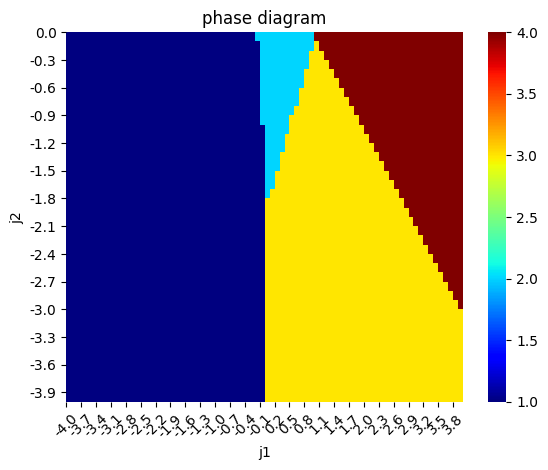

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Generate the heatmap without labels first
ax = sns.heatmap(mesh_phase, cmap="jet", xticklabels=False, yticklabels=False)

# Define the tick positions and labels
x_ticks = np.arange(0, len(np.arange(-4, 4, 0.1)), 3)  # Every third tick position
y_ticks = np.arange(0, len(np.arange(0, -4, -0.1)), 3)  # Every third tick position

x_labels = np.round(np.arange(-4, 4, 0.1), 2)[::3]  # Every third tick label
y_labels = np.round(np.arange(0, -4, -0.1), 2)[::3]  # Every third tick label

# Set the tick positions and labels on the plot
ax.set_xticks(x_ticks)
ax.set_xticklabels(x_labels,rotation=45)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)

# Customize the plot
plt.title("phase diagram")
plt.xlabel("j1")
plt.ylabel("j2")
plt.show()

In [ ]:
df=pd.DataFrame(base_dict)


In [ ]:
base_dict={"J1":J1_list,"J2":J2_list,"mag_x":mag_x,"mesh_y":mesh_y,"mesh_z":mesh_z,"gap":mesh_gap,"entropy":mesh_entropy,"cv":mesh_cv,"chi":mesh_chi,"ground_state":ground_states}
df=pd.DataFrame(base_dict)


In [ ]:
df

NameError: name 'df' is not defined

In [ ]:
analyse_df=df.merge(phase_df,how="inner",on=["J1","J2"])

In [ ]:

phase_df.to_csv("phase_df.csv")

In [ ]:
phase_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3200 entries, 0 to 3199
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   J1      3200 non-null   float64
 1   J2      3200 non-null   float64
 2   phase   3200 non-null   int64  
dtypes: float64(2), int64(1)
memory usage: 75.1 KB


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600 entries, 0 to 1599
Columns: 258 entries, J1 to 255
dtypes: float64(258)
memory usage: 3.1 MB


In [ ]:
df.to_csv("df.csv")

TypeError: DataFrame.merge() got an unexpected keyword argument 'ignore_index'

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt


IndexError: index 40 is out of bounds for axis 1 with size 40

## analysis of phases

In [ ]:
analyse_df

,J1,J2,mag_x,mesh_y,mesh_z,gap,entropy,cv,chi,ground_state,phase
0,-40,0,3.999782,0.0,-0.100047,0.009549,2.513949e-15,0.000715,0.000723,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",1
1,-40,-1,3.999782,0.0,-0.100004,0.009361,1.387872e-03,0.000717,0.000716,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",1
2,-40,-2,3.999782,0.0,-0.099875,0.008807,4.778727e-03,0.000723,0.000695,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",1
3,-40,-3,3.999782,0.0,-0.099660,0.007921,9.743037e-03,0.000734,0.000662,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",1
4,-40,-4,3.999782,0.0,-0.099360,0.006761,1.606074e-02,0.000751,0.000618,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",1
...,...,...,...,...,...,...,...,...,...,...,...
3275,39,-35,3.999782,0.0,-2.461594,2.302833,3.014323e-03,0.744764,0.229999,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",3
3276,39,-36,3.999782,0.0,-2.528056,2.445033,3.001318e-03,0.726172,0.207980,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",3
3277,39,-37,3.999782,0.0,-2.592303,2.590316,2.982508e-03,0.703517,0.186932,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",3
3278,39,-38,3.999782,0.0,-2.654254,2.738520,2.958499e-03,0.677355,0.167037,"Quantum object: dims=[[2, 2, 2, 2, 2, 2, 2, 2]...",3


In [ ]:
from qutip import tensor, sigmax, sigmay, sigmaz, qeye, expect
import numpy as np

def measure_qubit_expectations(state):
    num_qubits = int(np.log2(state.shape[0]))

    # Define Pauli matrices for a single qubit
    sx = sigmax()
    sy = sigmay()
    sz = sigmaz()

    # Function to create the operator acting on the i-th qubit
    def pauli_operator_on_qubit(op, qubit_idx, num_qubits):
        operators = [qeye(2)] * num_qubits  # Start with identity on all qubits
        operators[qubit_idx] = op  # Replace with the Pauli operator on the i-th qubit
        return tensor(operators)

    # Array to hold expectation vectors for each qubit
    expectation_vectors = np.zeros((num_qubits, 3))

    for i in range(num_qubits):
        sx_i = pauli_operator_on_qubit(sx, i, num_qubits)
        sy_i = pauli_operator_on_qubit(sy, i, num_qubits)
        sz_i = pauli_operator_on_qubit(sz, i, num_qubits)

        expectation_vectors[i, 0] = expect(sx_i, state)
        expectation_vectors[i, 1] = expect(sy_i, state)
        expectation_vectors[i, 2] = expect(sz_i, state)

    return expectation_vectors



In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection, Line3DCollection
import numpy as np

def draw_cube_with_custom_arrows(radius_vectors):
    # Create figure and 3D axes
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Define the vertices of a cube
    vertices = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0],
                         [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1]])

    # Define the six faces of the cube
    faces = [[vertices[j] for j in [0, 1, 2, 3]],
             [vertices[j] for j in [4, 5, 6, 7]],
             [vertices[j] for j in [0, 1, 5, 4]],
             [vertices[j] for j in [2, 3, 7, 6]],
             [vertices[j] for j in [0, 3, 7, 4]],
             [vertices[j] for j in [1, 2, 6, 5]]]

    # Create a 3D polygon collection for the faces
    cube = Poly3DCollection(faces, alpha=0.25, facecolor='cyan')

    # Add the cube faces to the plot
    ax.add_collection3d(cube)

    # Define the edges of the cube
    edges = [[vertices[j] for j in [0, 1]], [vertices[j] for j in [1, 2]],
             [vertices[j] for j in [2, 3]], [vertices[j] for j in [3, 0]],
             [vertices[j] for j in [4, 5]], [vertices[j] for j in [5, 6]],
             [vertices[j] for j in [6, 7]], [vertices[j] for j in [7, 4]],
             [vertices[j] for j in [0, 4]], [vertices[j] for j in [1, 5]],
             [vertices[j] for j in [2, 6]], [vertices[j] for j in [3, 7]]]

    # Create a 3D line collection for the edges
    cube_edges = Line3DCollection(edges, colors='k', linewidths=1.5)

    # Add the edges to the plot
    ax.add_collection3d(cube_edges)

    # Plot the vertices (electrons) as small circles
    ax.scatter(vertices[:, 0], vertices[:, 1], vertices[:, 2], color='red', s=100)

    # Plot arrows based on the input radius vectors
    for i, v in enumerate(vertices):
        rv = radius_vectors[i]
        ax.quiver(v[0], v[1], v[2], rv[0], rv[1], rv[2], color='blue', arrow_length_ratio=0.3)

    # Set the limits
    ax.set_xlim([-0.5, 1.5])
    ax.set_ylim([-0.5, 1.5])
    ax.set_zlim([-0.5, 1.5])

    # Remove the grid and set the background to white
    ax.grid(False)
    ax.set_facecolor('white')

    # Remove the tick labels and the ticks
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])

    # Remove the axis panes and set pane color to white
    ax.xaxis.pane.fill = False
    ax.yaxis.pane.fill = False
    ax.zaxis.pane.fill = False
    ax.xaxis.pane.set_edgecolor('white')
    ax.yaxis.pane.set_edgecolor('white')
    ax.zaxis.pane.set_edgecolor('white')

    # Turn off the axes completely
    ax.axis('off')

    # Show the plot
    plt.show()


In [ ]:
phase_1_mag=analyse_df[analyse_df.phase==1].ground_state.apply(measure_qubit_expectations)

In [ ]:
np.mean(phase_1_mag.values,axis=0)

array([[ 1.13063492e-01,  0.00000000e+00, -2.89646884e-01],
       [ 1.13063492e-01,  0.00000000e+00, -2.89646884e-01],
       [ 1.13063492e-01,  0.00000000e+00, -2.89646884e-01],
       [ 1.13063492e-01,  0.00000000e+00, -2.89646884e-01],
       [ 6.77443402e-15,  0.00000000e+00, -2.65346332e-01],
       [-6.77452514e-15,  0.00000000e+00, -2.65346332e-01],
       [ 6.77598756e-15,  0.00000000e+00, -2.65346332e-01],
       [-6.77711095e-15,  0.00000000e+00, -2.65346332e-01]])

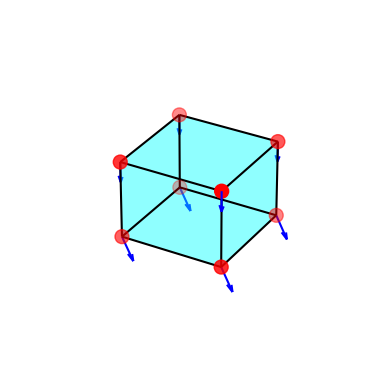

In [ ]:
draw_cube_with_custom_arrows(np.mean(phase_1_mag.values,axis=0))

In [ ]:
phase_2_mag=analyse_df[analyse_df.phase==2].ground_state.apply(measure_qubit_expectations)

In [ ]:
np.mean(phase_2_mag.values,axis=0)

array([[ 5.35759944e-01,  0.00000000e+00, -7.63609180e-01],
       [ 5.35759944e-01,  0.00000000e+00, -7.63609180e-01],
       [ 5.35759944e-01,  0.00000000e+00, -7.63609180e-01],
       [ 5.35759944e-01,  0.00000000e+00, -7.63609180e-01],
       [-3.01207711e-18,  0.00000000e+00, -9.73282958e-01],
       [-2.50878649e-18,  0.00000000e+00, -9.73282958e-01],
       [-1.94585973e-18,  0.00000000e+00, -9.73282958e-01],
       [ 1.45467429e-18,  0.00000000e+00, -9.73282958e-01]])

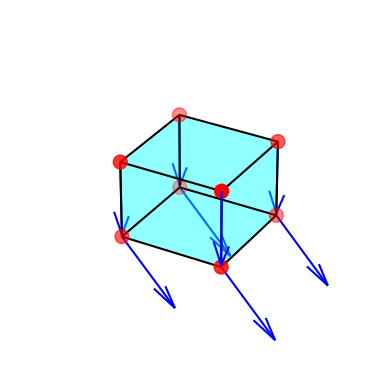

In [ ]:
draw_cube_with_custom_arrows(np.mean(phase_2_mag.values,axis=0))

In [ ]:
phase_3_mag=analyse_df[analyse_df.phase==3].ground_state.apply(measure_qubit_expectations)

In [ ]:
np.mean(phase_3_mag.values,axis=0)

array([[ 9.69583357e-01,  0.00000000e+00, -2.18211916e-01],
       [ 9.69583357e-01,  0.00000000e+00, -2.18211916e-01],
       [ 9.69583357e-01,  0.00000000e+00, -2.18211916e-01],
       [ 9.69583357e-01,  0.00000000e+00, -2.18211916e-01],
       [ 3.16207025e-18,  0.00000000e+00, -8.92133915e-01],
       [ 1.90044447e-18,  0.00000000e+00, -8.92133915e-01],
       [ 2.44624971e-18,  0.00000000e+00, -8.92133915e-01],
       [ 1.59542587e-18,  0.00000000e+00, -8.92133915e-01]])

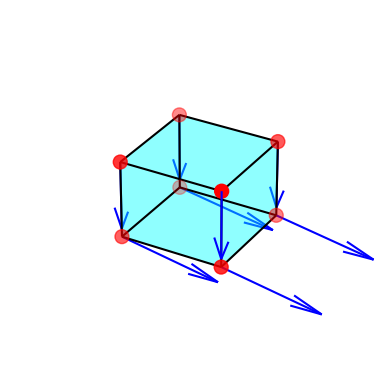

In [ ]:
draw_cube_with_custom_arrows(np.mean(phase_3_mag.values,axis=0))

In [ ]:
phase_4_mag=analyse_df[analyse_df.phase==4].ground_state.apply(measure_qubit_expectations)

In [ ]:
np.mean(phase_4_mag.values,axis=0)

array([[ 9.15531438e-01,  0.00000000e+00, -1.80715886e-01],
       [ 9.15531438e-01,  0.00000000e+00, -1.80715886e-01],
       [ 9.15531438e-01,  0.00000000e+00, -1.80715886e-01],
       [ 9.15531438e-01,  0.00000000e+00, -1.80715886e-01],
       [-1.32336137e-16,  0.00000000e+00, -4.26139721e-01],
       [-1.33354173e-16,  0.00000000e+00, -4.26139721e-01],
       [-1.32200571e-16,  0.00000000e+00, -4.26139721e-01],
       [-1.33455154e-16,  0.00000000e+00, -4.26139721e-01]])

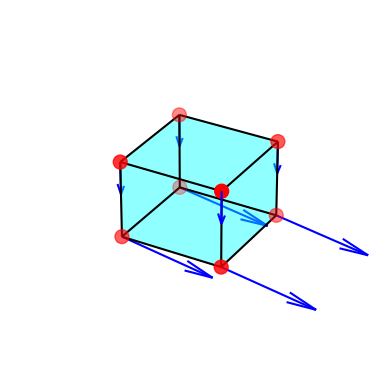

In [ ]:
draw_cube_with_custom_arrows(np.mean(phase_4_mag.values,axis=0))

In [ ]:
measure_qubit_expectations(analyse_df.ground_state[200])

array([[ 1.40555119e-32,  0.00000000e+00, -1.51300129e-01],
       [-1.40514935e-32,  0.00000000e+00, -1.51300129e-01],
       [ 1.40554962e-32,  0.00000000e+00, -1.51300129e-01],
       [-1.40123879e-32,  0.00000000e+00, -1.51300129e-01],
       [ 1.92287804e-14,  0.00000000e+00, -1.51300129e-01],
       [-1.92256432e-14,  0.00000000e+00, -1.51300129e-01],
       [ 1.92221637e-14,  0.00000000e+00, -1.51300129e-01],
       [-1.92249996e-14,  0.00000000e+00, -1.51300129e-01]])